In [1]:
import os
import numpy as np
import scipy
import sys

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline

import glob
from astropy.io import fits

sys.path.append('src/')
from utils import *
from dark_correct import *
from flat_field import *
from sky_subtraction import *

In [2]:
matplotlib.style.use('seaborn-ticks')
matplotlib.rc('lines', linewidth=2)
matplotlib.rc('axes', labelsize=30)
matplotlib.rc('figure', figsize=(12, 8))
matplotlib.rc('xtick', labelsize=30)
matplotlib.rc('ytick', labelsize=30)

/tmp/ipykernel_20691/1734511318.py:1: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  matplotlib.style.use('seaborn-ticks')


## Identify the data directory (where your data lives), and the output directory (where you want your final image to go), and let 'er rip! This next cell should automatically peruse your data directory for any fits files. It will then go through their headers and identify all the unique objects you've looked at, ignoring flats, darks, alignments, etc. At the end, you should have a list of all the targets that have data in that directory. Don't see your target? Make sure it's in the right directory!

In [3]:
datadir = 'Raw_Data/data-2024-01-28-AO-Paul.Robertson/'  #You change this!
outdir = '/home/tehan/Documents/ShaneAO/20240128/Results/'
os.makedirs(outdir, exist_ok=True)

#################################


files = [os.path.basename(x) for x in glob.glob(datadir + '*')]

#Want to make a target list for every target. This is the list that contains all target names, later
#We'll have a list for the data of every target
target_list = []

#Here we go through every file and check the objects name. If its a flat or a dark, we continue
#If it's a target, we check if it's in target_list. If it is, we continue. If it's not, we add it
for f in files:
    try:
        header = fits.getheader(datadir + f)
        obj = header['OBJECT']
        if (len(target_list) == 0 and 'dark' not in obj.lower() and 'flat' not in obj.lower()
                and 'alignment' not in obj.lower() and 'junk' not in obj.lower() and 'seeing' not in obj.lower()
                and 'optimization' not in obj.lower() and 'test' not in obj.lower()):
            target_list.append(obj)
        if obj in target_list:
            continue
        elif 'dark' in obj.lower():
            continue
        elif 'flat' in obj.lower():
            continue
        elif 'alignment' in obj.lower():
            continue
        elif 'junk' in obj.lower():
            continue
        elif 'seeing' in obj.lower():
            continue
        elif 'optimization' in obj.lower():
            continue
        elif 'test' in obj.lower():
            continue
        else:
            target_list.append(obj)
    except OSError:
        continue
    except KeyError:
        continue

#Optional part, but helpful. Sometimes the names of targets can mess up the later parts of this code, especially
#if they have strange characters. Here I replace two common ones with an acceptable replacement.

target_list_fixed = []

#The minus and + signs in some targets mess up the next part, so I replace them here
for i in range(len(target_list)):
    j = target_list[i].replace('-', '_')
    k = j.replace('+', 't')
    target_list_fixed.append(k)

target_list = target_list_fixed  #just change it's name back for consistency

print('List of all the targets in your data directory:')
print(target_list)



List of all the targets in your data directory:
['TIC_51159255', 'TIC_68581262', 'TOI_6303', 'TIC_10056120', 'TIC_446175401', 'TIC_456334158', 'TIC_283866910', 'TIC_166087190', 'TIC_17992446', 'TIC_172572159', 'TIC_144282456']


## Now You start off by picking a target from the list, and we will analyze that target. This next cell basically makes a list of all the files associated with that target. It also generates lists of flats and darks, and a few other odds and ends for use later

In [4]:
#We've identified our list of targets, now we pick our target and proceed
#I may go back and make this a loop at some point, but for now it is one at a time. 

#edit this line if you wanna change targets
target = target_list[5]
mantarglist = [747,748,875] #list(range(279,283)) + list(range(385, 396)) + list(range(402, 434)) # manual veto

#these definitions ensure that all these lists are redifined for every target. Though the flat list and the
#dark list should stay the same between runs, the object list will change on each iteration. Essentially, each
#iteration is a new target, and so this list gets recycled every time
flat_list = []  #list of all the flats, duh
dark_list = []  # list of all the darks, dummy!
object_list = []  #this is a list that contains all the FILES that each target has, every exposure. Not
#to be confused with the actual target list, which only has one entry for every star we looked at
drkhdr_list = []  #this keeps the header for each dark. This is useful later for when we're sorting these by 
#exposure time
tot_exptime = 0  # this keeps track of how many seconds total we looked at this target

#Open the text file with the vetos in it
#there is another script that reads everything and auto vetos stuff for SNR reasons, or other poor quality indicators
veto_list = [line.rstrip('\n') for line in open(datadir + 'veto_list.txt')]
#Now we organize this into flats and targets


print('Target: ' + target)
#make a list of frames to veto
flat_veto_list = []
target_veto_list = []

for veto in veto_list:
    header = fits.getheader(datadir + veto)
    obj = header['OBJECT']
    objf = obj.replace('-', '_')  #having trouble with minus/plus signs again
    objk = objf.replace('+', 't')
    if 'flat' in obj.lower():
        flat_veto_list.append(veto)
    elif objk == target:
        target_veto_list.append(veto)
    else:
        continue

for targ in mantarglist:
    target_veto_list.append(f's{targ:04d}.fits')
print(f'Veto: {set(target_veto_list)}')
##Let's add the ability to manually input vetos for this target; Let's manually put them in the veto list for now
# mantarglist = (list(map(str, input(str(target)+': Enter Manual Veto Targets in fits file form, delineated by spaces i.e. s0300.fits').split())))
# manflatlist = (list(map(str, input(str(target)+': Enter Manual Veto Flats in fits file form, delineated by spaces i.e. s0300.fits').split())))
#         
# for targ in mantarglist:
#     target_veto_list.append(targ)
#             
# for flat in manflatlist:
#     flat_veto_list.append(flat)

#This part basically takes objects and sorts them into either flats, darks, or targets
#Need to move flats/darks here, because I only want them by night
#The two if/else parts correspond to when the id is two digits or three
for f in files:
    try:
        header = fits.getheader(datadir + f)
        obj = header['OBJECT']
        objf = obj.replace('-', '_')  #having trouble with minus/plus signs again
        objk = objf.replace('+', 't')
        if 'flat' in obj.lower():
            flat_list.append(f)
        elif 'test' in obj.lower():
            flat_list.append(f)
        elif 'dark' in obj.lower():
            dark_list.append(f)
            drkhdr_list.append(int(float(header['ITIME']) / 1000))
        elif objk == target:
            object_list.append(f)
            tot_exptime = tot_exptime + float(header['ITIME']) / 1000
    except OSError:
        continue
    except KeyError:
        continue

#I recommend using this point to ensure that all the right fits files are here for each target
#These have not removed the veto frames yet
if (len(object_list) == 0):
    sys.exit('Nothing in the object list')

#Now we remove the bad/overexposed frames in the veto list           
for veto in target_veto_list:
    for ID in object_list:
        if ID == veto:
            object_list.remove(ID)
            continue

for veto in flat_veto_list:
    for ID in flat_list:
        if ID == veto:
            flat_list.remove(ID)
            continue

#We don't want targets with only a few images
if len(object_list) < 5:
    sys.exit('Too few images')

print('Object List:')

#let's make a list that contains all our exposures

all_images_list = []

all_images_list = flat_list + object_list + dark_list

object_filter_list = []

#let's make a list of all the filters for a target, in case they change        
for i in range(len(object_list)):
    try:
        header = fits.getheader(datadir + object_list[i])
        filt = header['FILT1NAM']
        if len(object_filter_list) == 0:
            object_filter_list.append(filt)
        elif filt not in object_filter_list:
            object_filter_list.append(filt)
    except OSError:
        continue

    ############# Get the Image Data   ###################

raw_image_data = {}

for image_name in all_images_list:
    try:
        raw_image_data[image_name] = fits.getdata(datadir + image_name)
    except OSError:
        continue

#now we want to loop and do the rest of the code for each filter, but we need to make a new target list
#for all the targets in a particular filter
object_filter_list2 = [object_filter_list[0]]

for filter_ in object_filter_list2:
    newobjectlist = []
    for j in range(len(object_list)):
        header = fits.getheader(datadir + object_list[j])
        filt = header['FILT1NAM']
        if filter_ == filt:
            newobjectlist.append(object_list[j])
        else:
            continue

object_list = newobjectlist
print(object_filter_list2)
print(object_list)

Target: TIC_456334158
Veto: {'s0747.fits', 's0875.fits', 's0748.fits'}
Object List:
['Ks']
['s0789.fits', 's0802.fits', 's0759.fits', 's0830.fits', 's0791.fits', 's0868.fits', 's0872.fits', 's0814.fits', 's0844.fits', 's0804.fits', 's0831.fits', 's0828.fits', 's0801.fits', 's0821.fits', 's0806.fits', 's0874.fits', 's0786.fits', 's0846.fits', 's0860.fits', 's0817.fits', 's0779.fits', 's0765.fits', 's0750.fits', 's0755.fits', 's0751.fits', 's0805.fits', 's0833.fits', 's0838.fits', 's0837.fits', 's0853.fits', 's0760.fits', 's0863.fits', 's0825.fits', 's0871.fits', 's0813.fits', 's0864.fits', 's0873.fits', 's0834.fits', 's0768.fits', 's0776.fits', 's0841.fits', 's0753.fits', 's0800.fits', 's0848.fits', 's0850.fits', 's0780.fits', 's0866.fits', 's0862.fits', 's0852.fits', 's0761.fits', 's0766.fits', 's0752.fits', 's0811.fits', 's0762.fits', 's0754.fits', 's0851.fits', 's0845.fits', 's0818.fits', 's0756.fits', 's0819.fits', 's0858.fits', 's0815.fits', 's0785.fits', 's0798.fits', 's0865.fits'

In [5]:
################################
#       Dark Correction        #
################################

darkcor_list_in = object_list + flat_list  #we will dark correct all object images and flat images

#make a master dark for each exposure time
master_dark_dict = generate_master_darks(dark_list, drkhdr_list, datadir)

darkcor_data_out = {}  ## dictionary for the dark-corrected images

for im in darkcor_list_in:
    try:
        darkcor_data_out[im] = dark_correct(im, raw_image_data, master_dark_dict, datadir)
    except OSError:
        continue
    # except KeyError:
    #     continue



Now correcting s0789.fits using exposure time 9 s
Now correcting s0802.fits using exposure time 9 s
Now correcting s0759.fits using exposure time 9 s
Now correcting s0830.fits using exposure time 9 s
Now correcting s0791.fits using exposure time 9 s
Now correcting s0868.fits using exposure time 9 s
Now correcting s0872.fits using exposure time 9 s
Now correcting s0814.fits using exposure time 9 s
Now correcting s0844.fits using exposure time 9 s
Now correcting s0804.fits using exposure time 9 s
Now correcting s0831.fits using exposure time 9 s
Now correcting s0828.fits using exposure time 9 s
Now correcting s0801.fits using exposure time 9 s
Now correcting s0821.fits using exposure time 9 s
Now correcting s0806.fits using exposure time 9 s
Now correcting s0874.fits using exposure time 9 s
Now correcting s0786.fits using exposure time 9 s
Now correcting s0846.fits using exposure time 9 s
Now correcting s0860.fits using exposure time 9 s
Now correcting s0817.fits using exposure time 9 s


/home/tehan/PycharmProjects/Shane-AO-Reduction/src/flat_field.py:37: RuntimeWarning: invalid value encountered in true_divide
  flat_darkcor_data_out[im] = darkcor_data_out[im]/master_flat
/home/tehan/PycharmProjects/Shane-AO-Reduction/src/utils.py:33: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(np.log10(B), origin='lower', cmap='gray')
/home/tehan/PycharmProjects/Shane-AO-Reduction/src/utils.py:33: RuntimeWarning: invalid value encountered in log10
  plt.imshow(np.log10(B), origin='lower', cmap='gray')


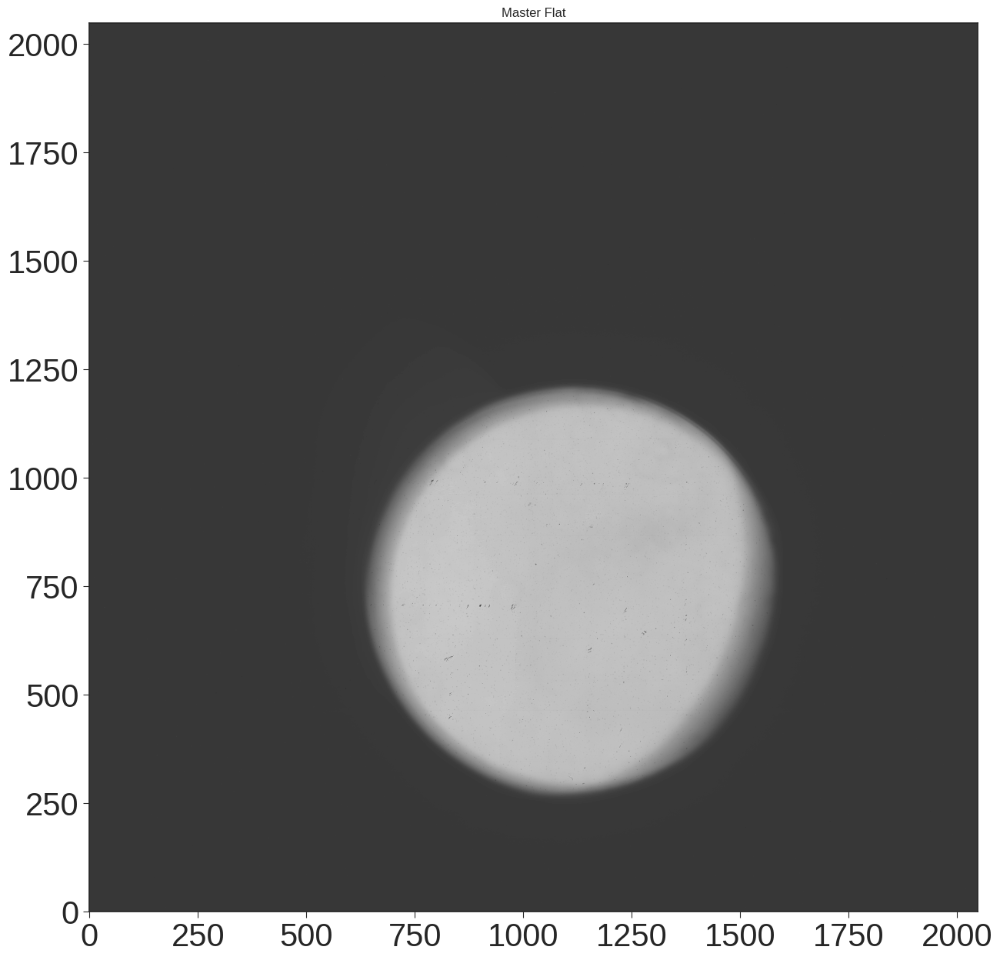

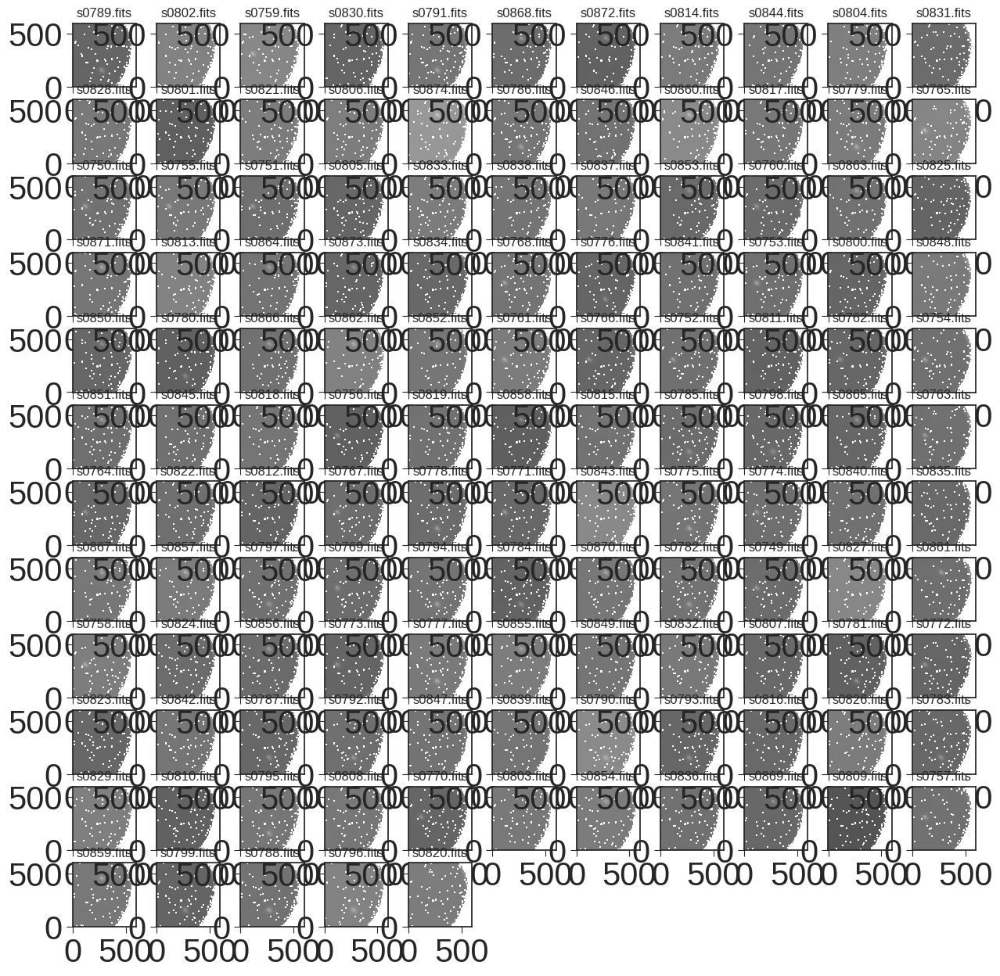

In [6]:
################################
#       Flat Correction        #
################################


#make a master flat
master_flat = make_master_flats(flat_list, filter_, darkcor_data_out, datadir)

#plot it
plt.figure(figsize=(15, 15))
plt.imshow((master_flat), origin='lower', cmap='gray')
plt.title('Master Flat')

#flat field the images
flat_darkcor_data_out = flat_field(object_list, master_flat, darkcor_data_out)

targetcube_window = np.stack(
    [flat_darkcor_data_out[science_frame][400:1000, 1050:1650] for science_frame in object_list],
    axis=0)  # [450:1050,850:1450]

## show the images: 
plot_grid(targetcube_window, object_list)


In [7]:
################################
#          Sigma Clip          #
################################

flat_darkcor_sigmacut_data = sigma_clip(object_list, flat_darkcor_data_out)
#flat_darkcor_sigmacut_data = flat_darkcor_data_out

s0789.fits
s0802.fits
s0759.fits
s0830.fits
s0791.fits
s0868.fits
s0872.fits
s0814.fits
s0844.fits
s0804.fits
s0831.fits
s0828.fits
s0801.fits
s0821.fits
s0806.fits
s0874.fits
s0786.fits
s0846.fits
s0860.fits
s0817.fits
s0779.fits
s0765.fits
s0750.fits
s0755.fits
s0751.fits
s0805.fits
s0833.fits
s0838.fits
s0837.fits
s0853.fits
s0760.fits
s0863.fits
s0825.fits
s0871.fits
s0813.fits
s0864.fits
s0873.fits
s0834.fits
s0768.fits
s0776.fits
s0841.fits
s0753.fits
s0800.fits
s0848.fits
s0850.fits
s0780.fits
s0866.fits
s0862.fits
s0852.fits
s0761.fits
s0766.fits
s0752.fits
s0811.fits
s0762.fits
s0754.fits
s0851.fits
s0845.fits
s0818.fits
s0756.fits
s0819.fits
s0858.fits
s0815.fits
s0785.fits
s0798.fits
s0865.fits
s0763.fits
s0764.fits
s0822.fits
s0812.fits
s0767.fits
s0778.fits
s0771.fits
s0843.fits
s0775.fits
s0774.fits
s0840.fits
s0835.fits
s0867.fits
s0857.fits
s0797.fits
s0769.fits
s0794.fits
s0784.fits
s0870.fits
s0782.fits
s0749.fits
s0827.fits
s0861.fits
s0758.fits
s0824.fits
s0856.fits

Sky Subtracting images with exp time = 9.0 s


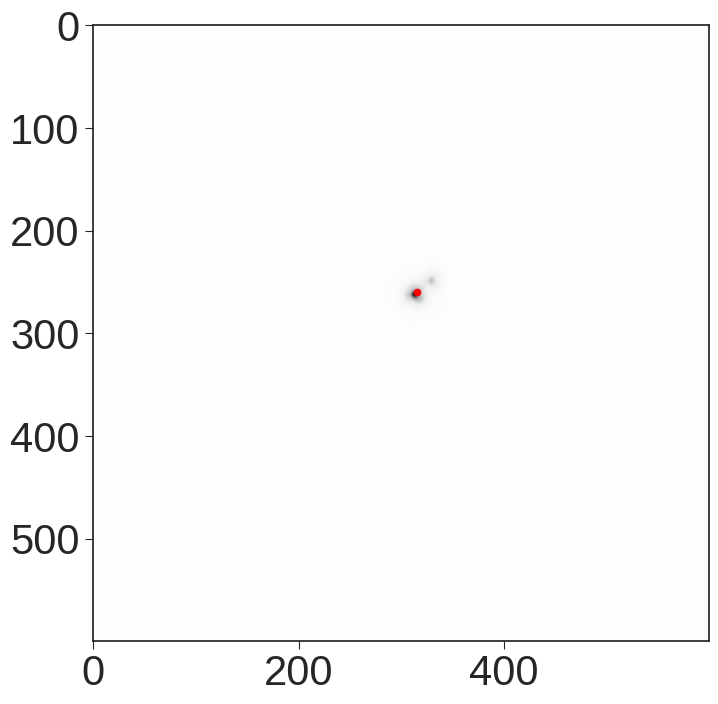

center position:  316 260


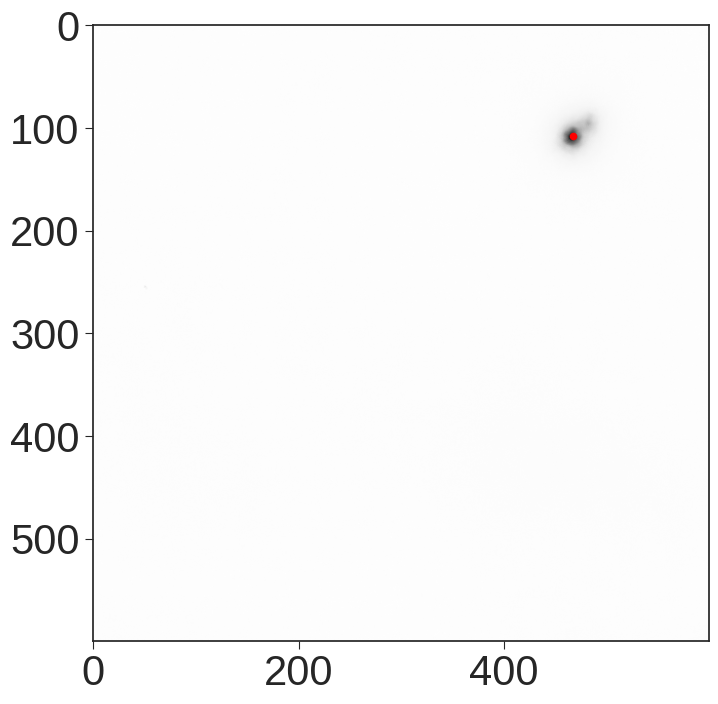

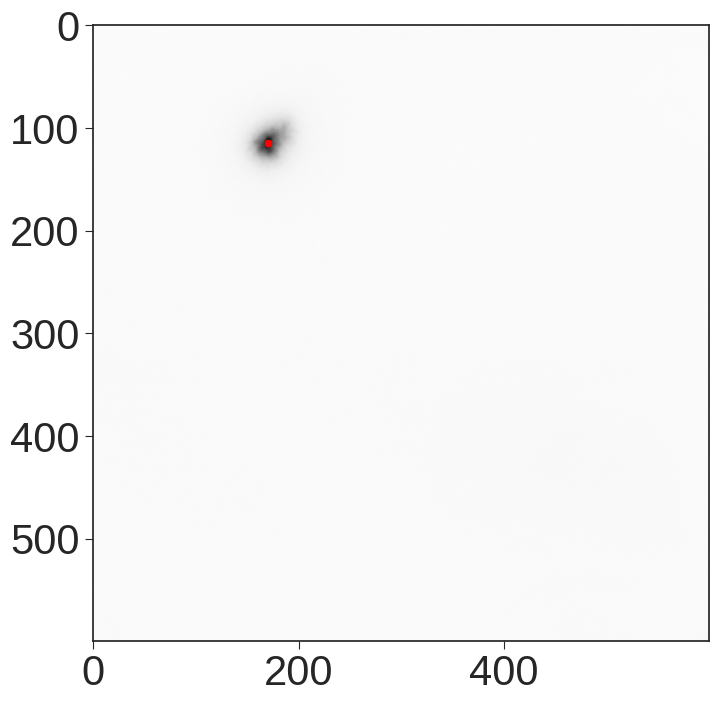

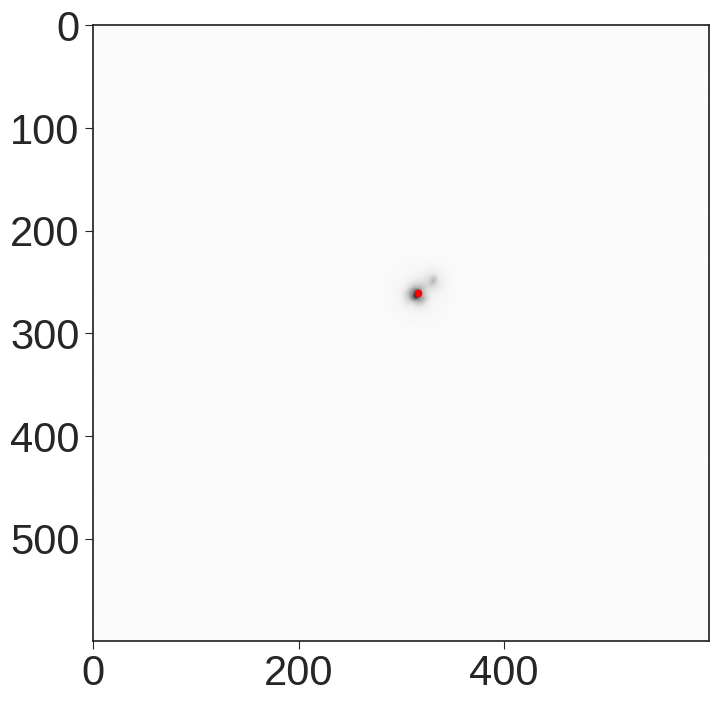

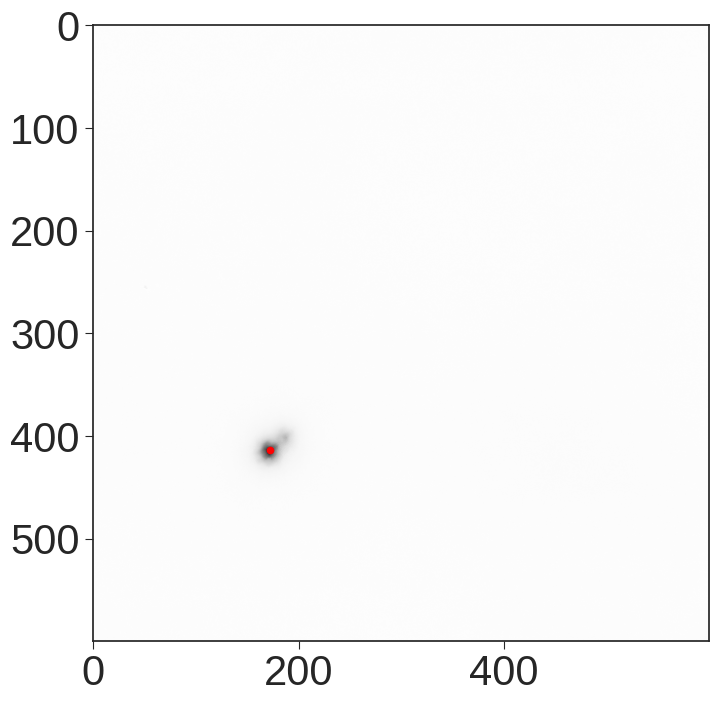

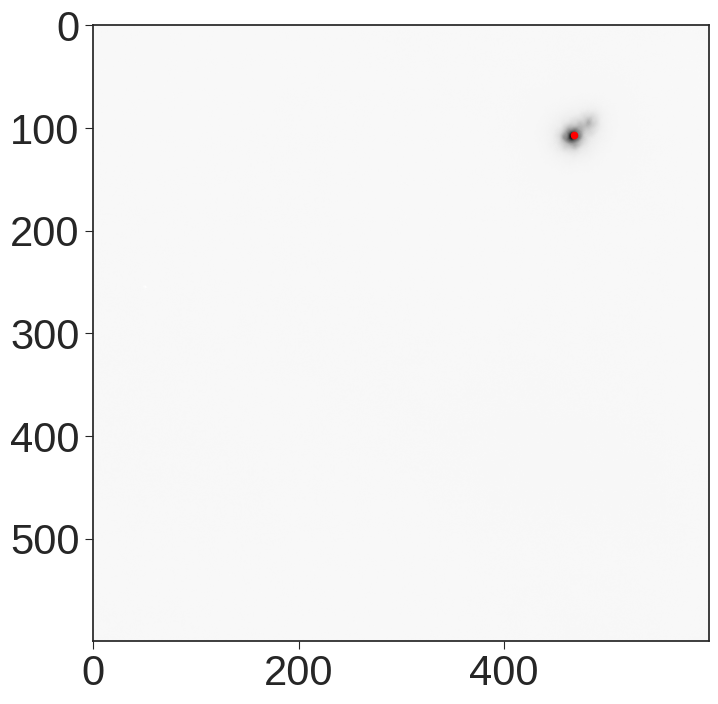

...

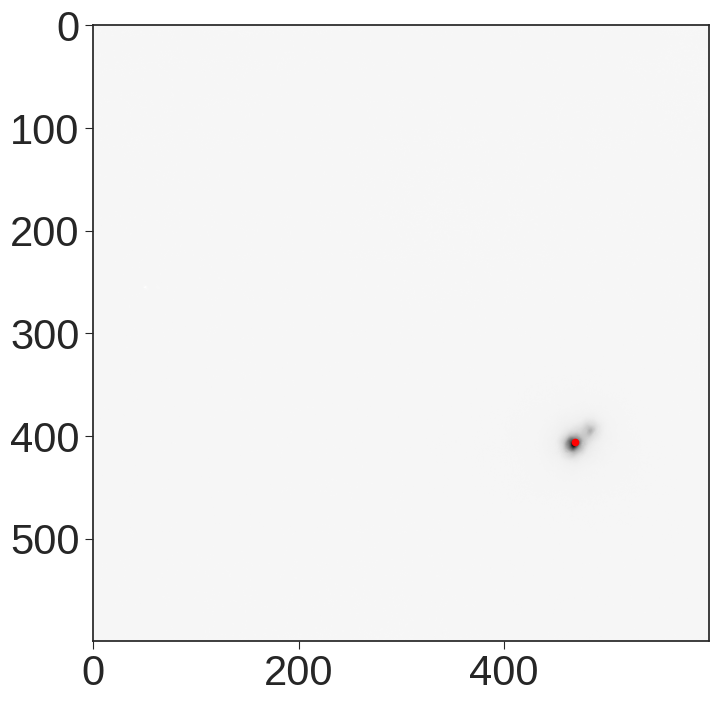

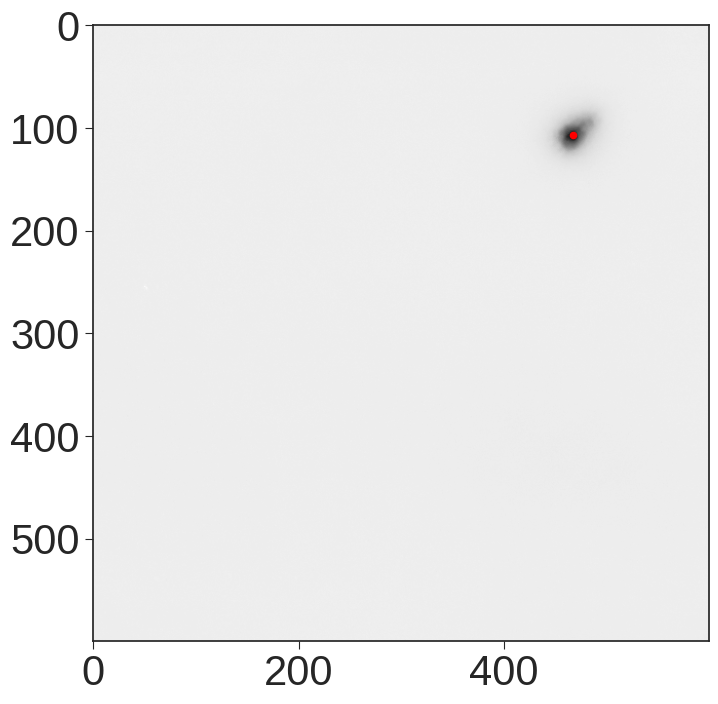

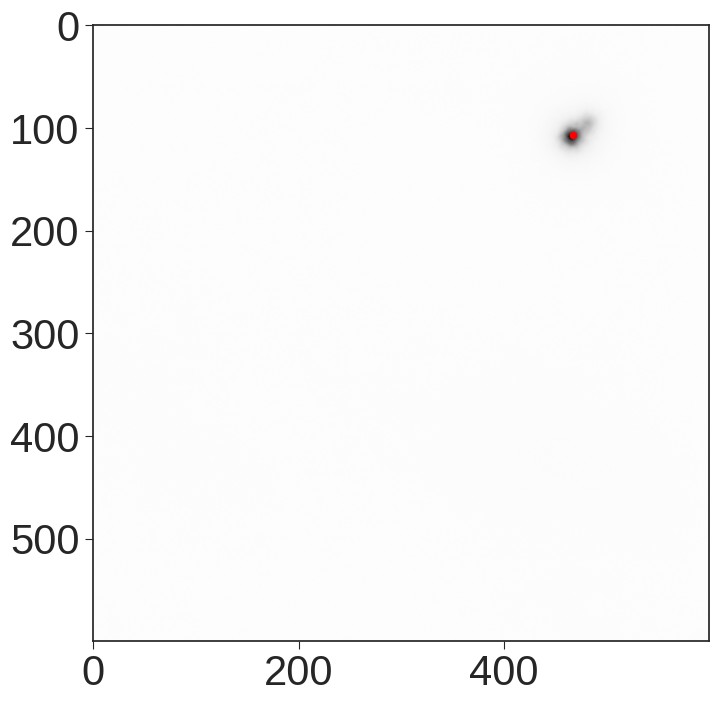

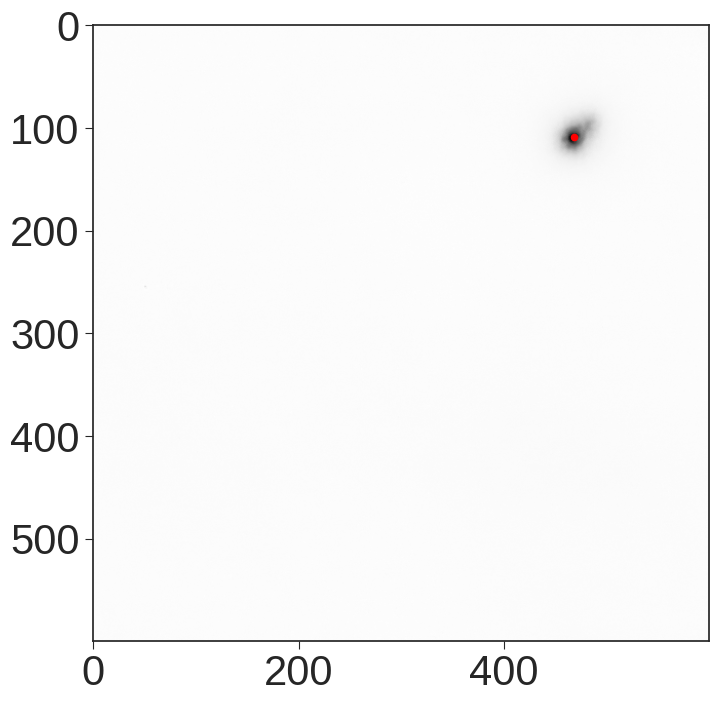

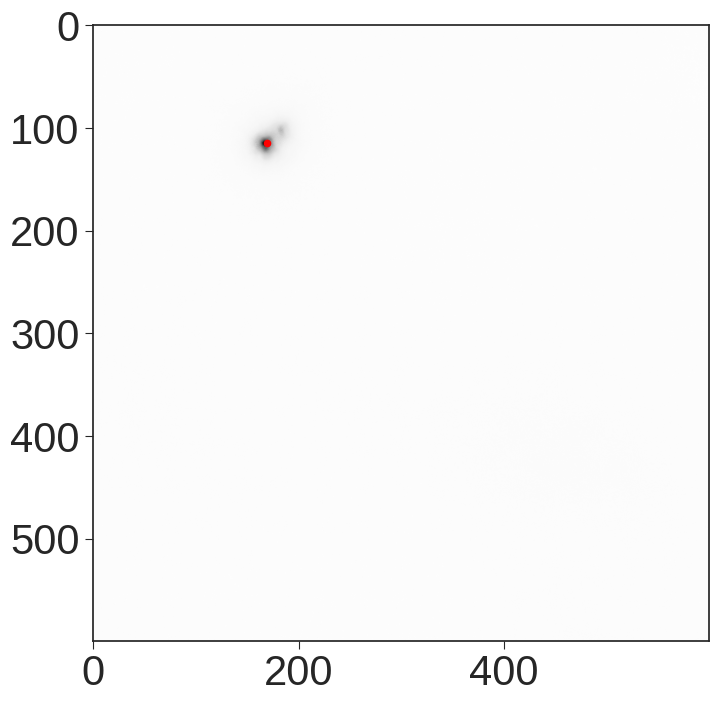

Positions = 5


<Figure size 1200x800 with 0 Axes>

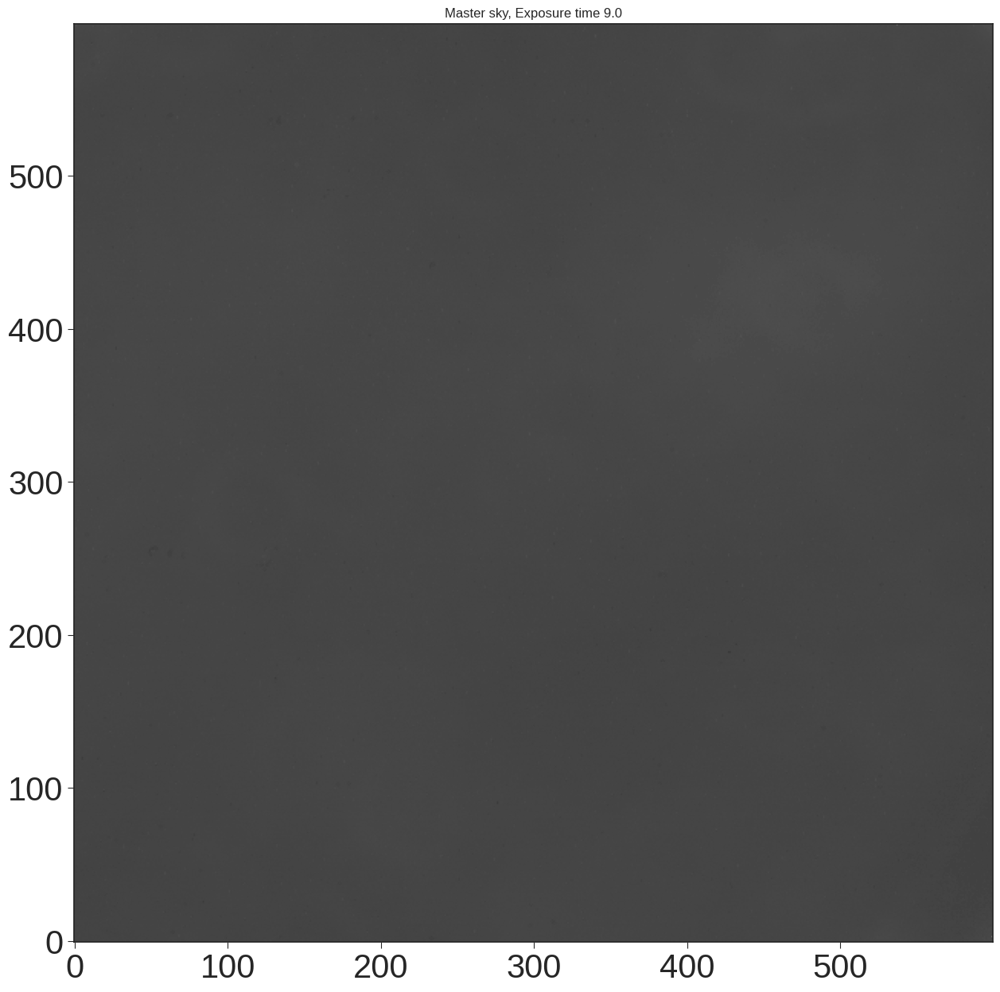

In [8]:
################################
#       Sky Subtraction        #
################################

master_sky, exp_dict, center = make_master_sky(object_list, flat_darkcor_sigmacut_data, datadir)
exposuretimes = master_sky.keys()

graymin = 1.25
graymax = 3

for key in exposuretimes:
    plt.figure(1)
    plt.figure(figsize=(15, 15));
    plt.title('Master sky, Exposure time ' + str(key));
    plt.imshow(np.log10(master_sky[key]), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
    plt.show()

sky_flat_darkcor_data_out = sky_subtract(object_list, exposuretimes, flat_darkcor_sigmacut_data, exp_dict, master_sky)




/tmp/ipykernel_20691/520747540.py:27: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(np.log10(data_im1[450:1050, 850:1450]), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
/tmp/ipykernel_20691/520747540.py:27: RuntimeWarning: invalid value encountered in log10
  plt.imshow(np.log10(data_im1[450:1050, 850:1450]), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
/tmp/ipykernel_20691/520747540.py:32: RuntimeWarning: invalid value encountered in log10
  plt.imshow(np.log10(data_im1_d[450:1050, 850:1450]), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
/tmp/ipykernel_20691/520747540.py:37: RuntimeWarning: invalid value encountered in log10
  plt.imshow(np.log10(data_im1_d_f[450:1050, 850:1450]), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
/tmp/ipykernel_20691/520747540.py:47: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(np.log10(data_im1_d_f_s_s), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
/tmp/ipyk

<Figure size 1200x800 with 0 Axes>

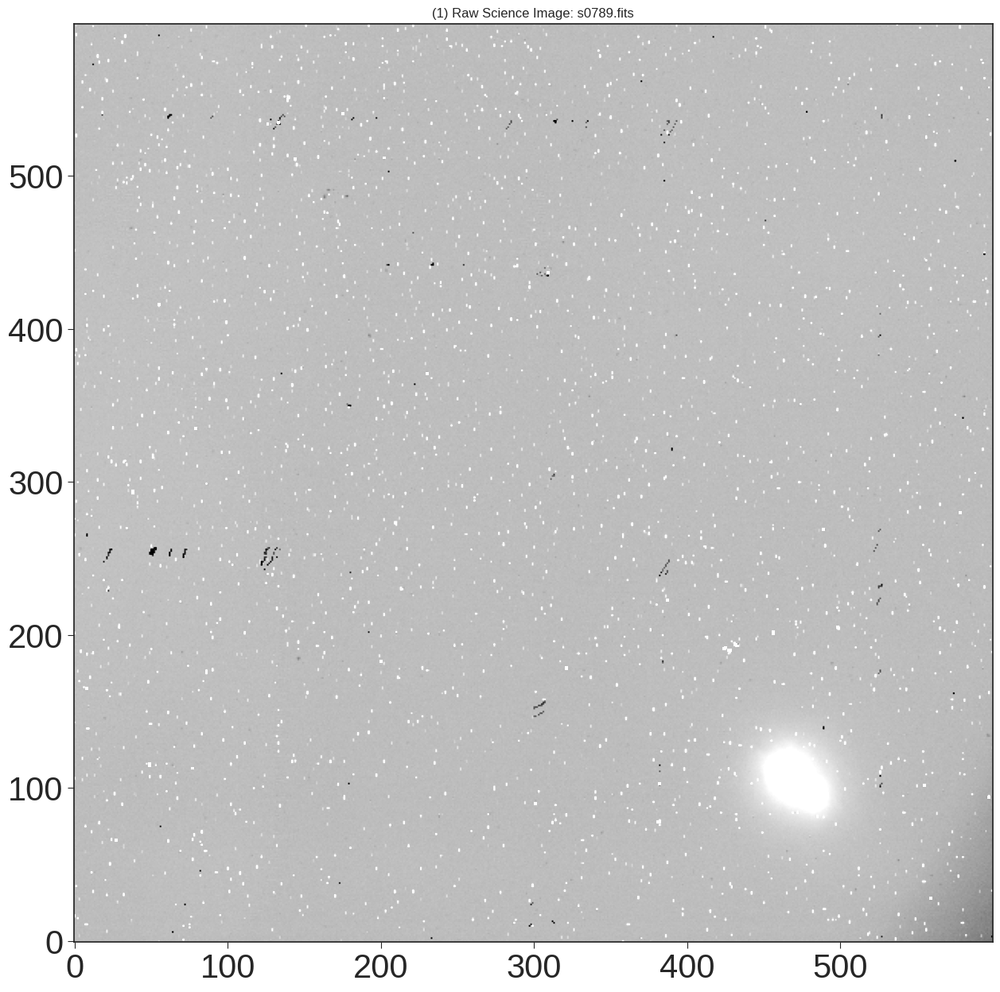

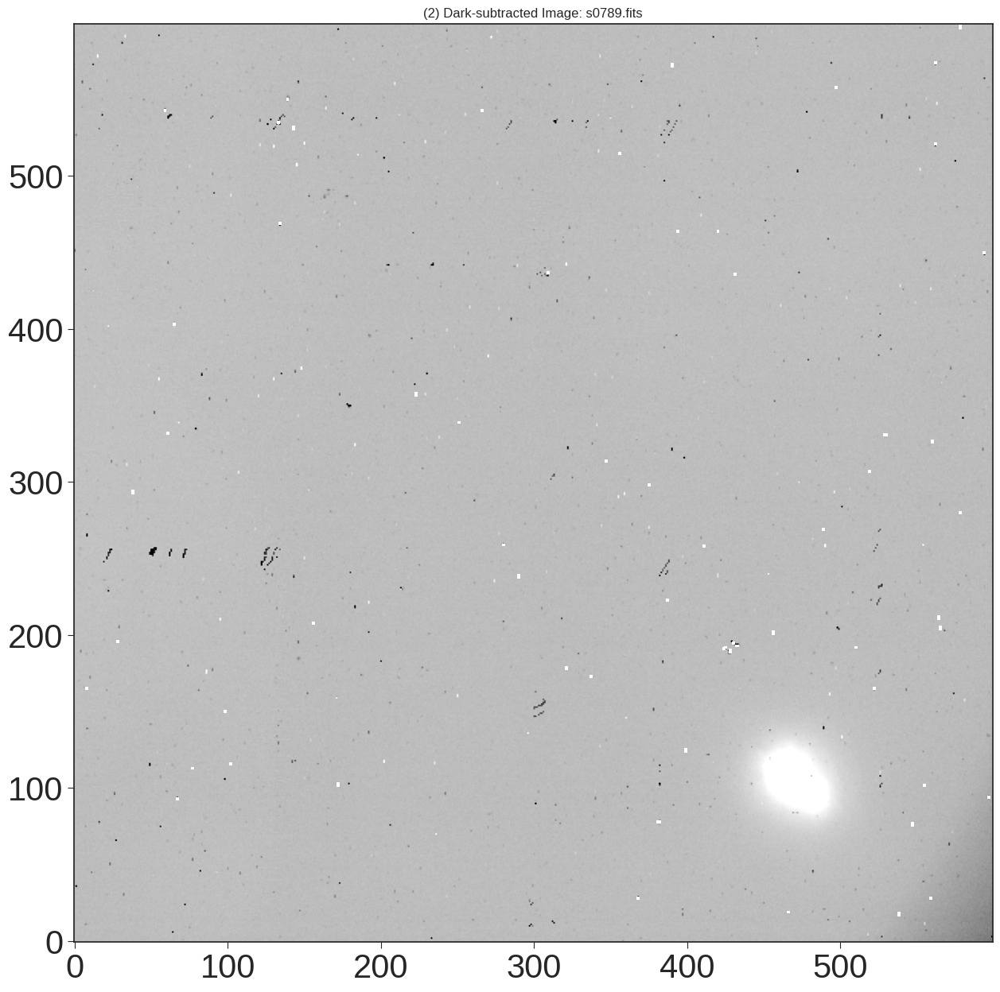

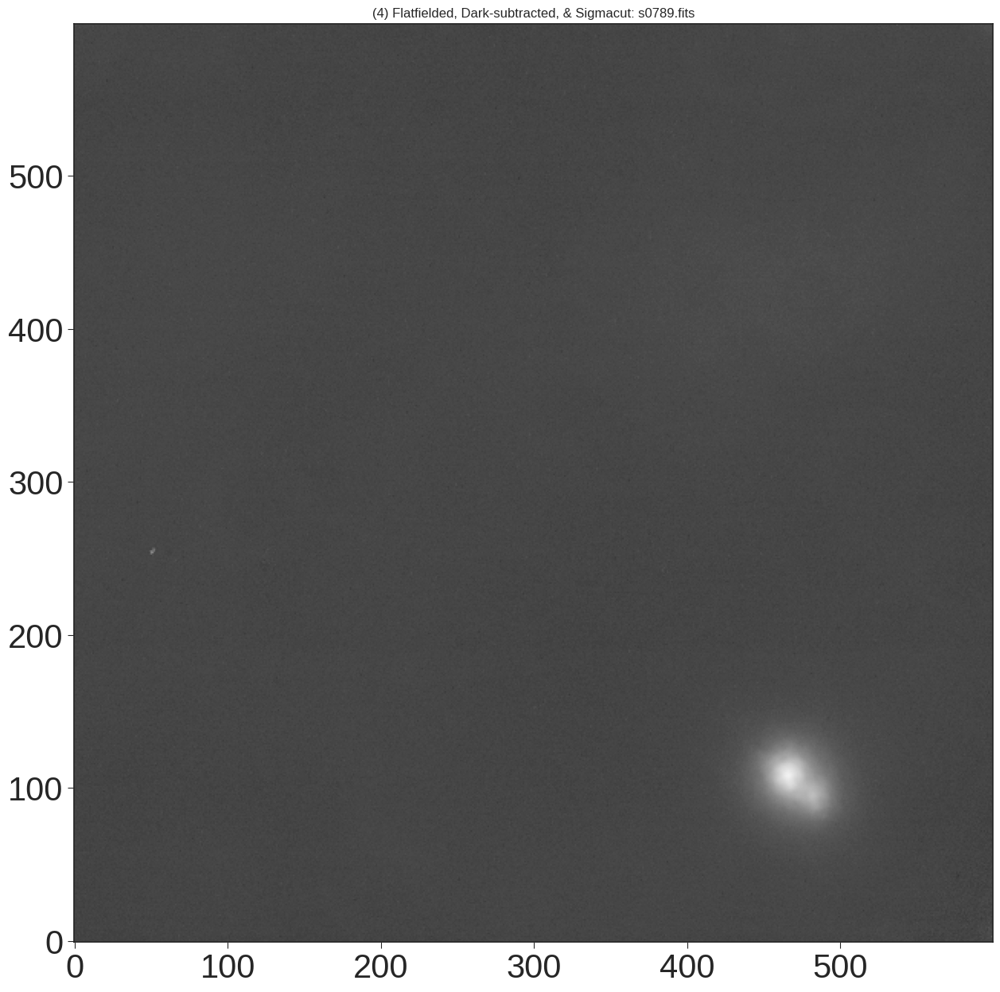

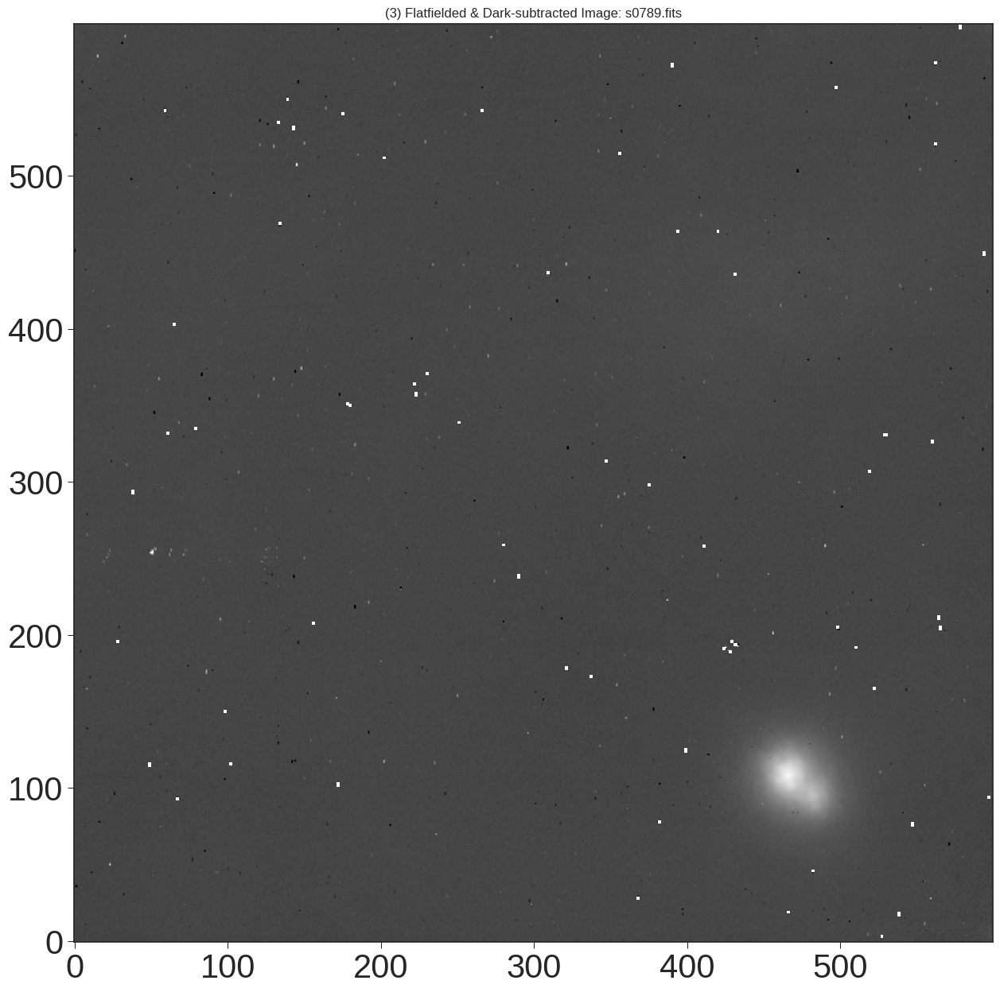

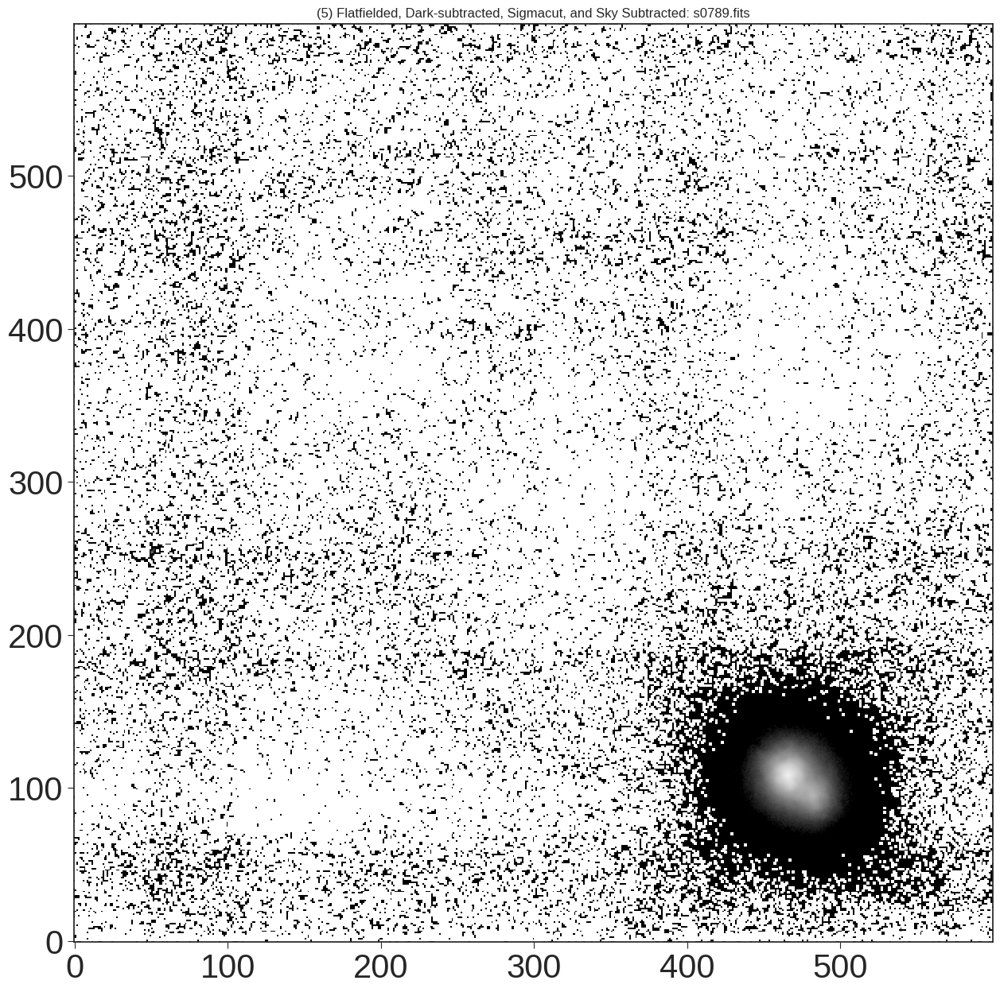

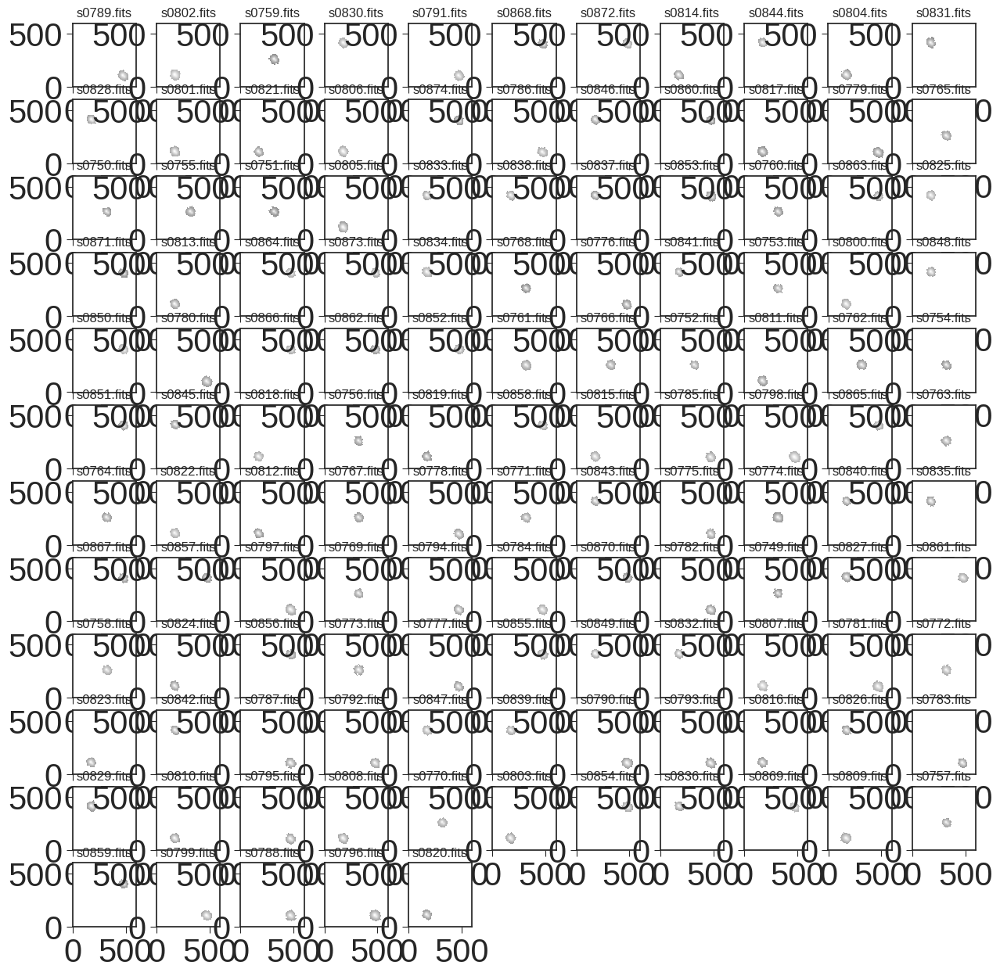

In [9]:
# so if we compare the initial raw science frame (1), to a dark-corrected (2), a flatfield & dark-corrected frame (3), and CR-removed (4) 
# we can see the progression in lessening noise

## grayscale mapping min/max values: 


im = 0  ## the image we're looking at.

## (1) raw image
im1 = object_list[im]
data_im1 = raw_image_data[im1]

## (2) dark-corrected image
data_im1_d = darkcor_data_out[im1]

## (3) flattened and dark-corrected image
data_im1_d_f = flat_darkcor_data_out[im1]

## (4) flattened, dark-corrected, Sigma_Cut, and Sky Subtracted Image
data_im1_d_f_s = flat_darkcor_sigmacut_data[im1]

## (5) flattened, dark-corrected, Sigma_Cut, and Sky Subtracted Image
data_im1_d_f_s_s = sky_flat_darkcor_data_out[im1]

plt.figure(1)
plt.figure(figsize=(15, 15))
plt.imshow(np.log10(data_im1[450:1050, 850:1450]), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
plt.title('(1) Raw Science Image: ' + im1)

plt.figure(2)
plt.figure(figsize=(15, 15))
plt.imshow(np.log10(data_im1_d[450:1050, 850:1450]), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
plt.title('(2) Dark-subtracted Image: ' + im1)

plt.figure(3)
plt.figure(figsize=(15, 15))
plt.imshow(np.log10(data_im1_d_f[450:1050, 850:1450]), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
plt.title('(3) Flatfielded & Dark-subtracted Image: ' + im1)

plt.figure(4)
plt.figure(figsize=(15, 15))
plt.imshow(np.log10(data_im1_d_f_s), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
plt.title('(4) Flatfielded, Dark-subtracted, & Sigmacut: ' + im1)

plt.figure(4)
plt.figure(figsize=(15, 15))
plt.imshow(np.log10(data_im1_d_f_s_s), origin='lower', cmap='gray', vmin=graymin, vmax=graymax)
plt.title('(5) Flatfielded, Dark-subtracted, Sigmacut, and Sky Subtracted: ' + im1)

#let's see if some cleanup here helps

#del flat_darkcor_data_out


## create an array of corrected target images
targetcube = np.stack([sky_flat_darkcor_data_out[science_frame] for science_frame in object_list], axis=0)

## show the images: 
plot_grid(targetcube, object_list)



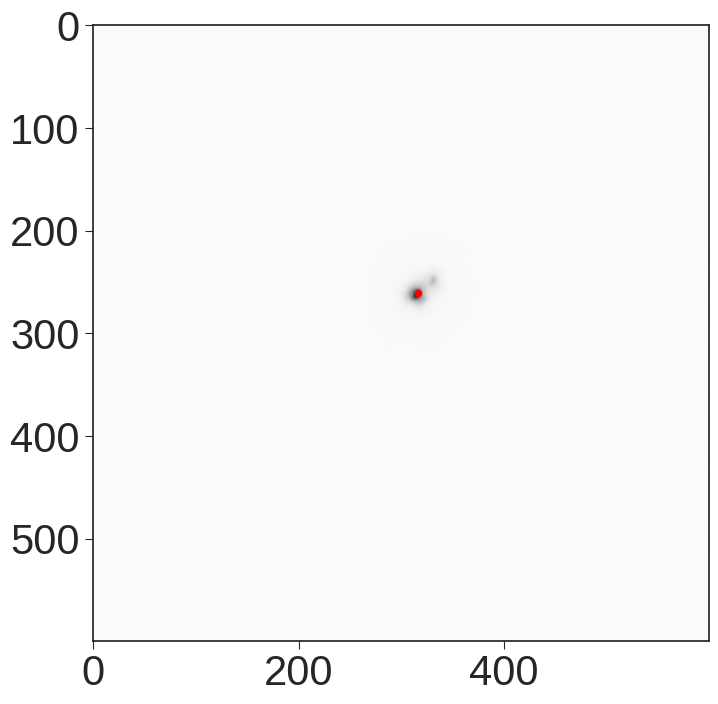

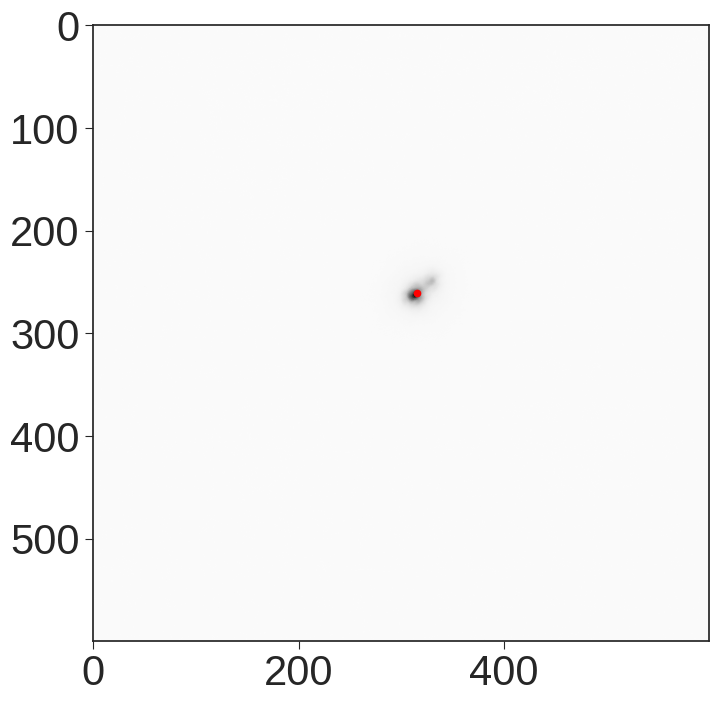

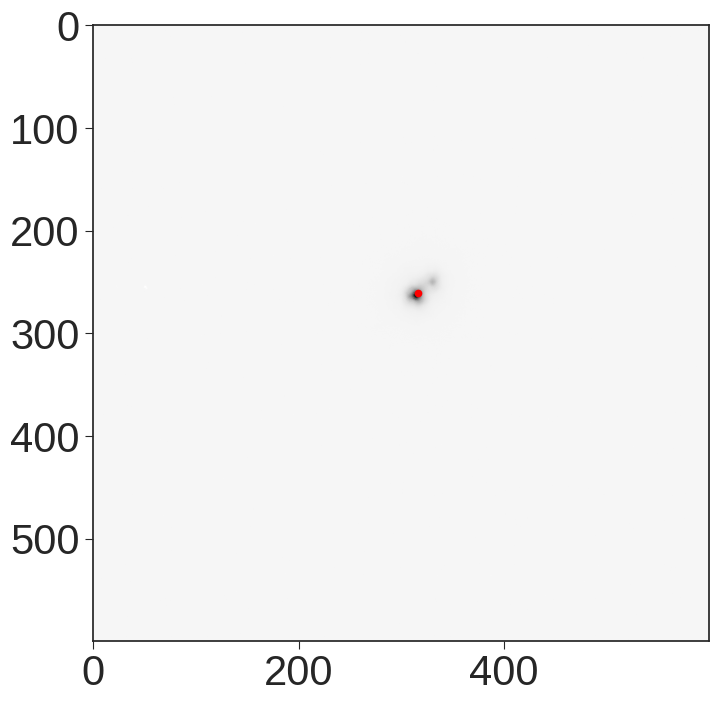

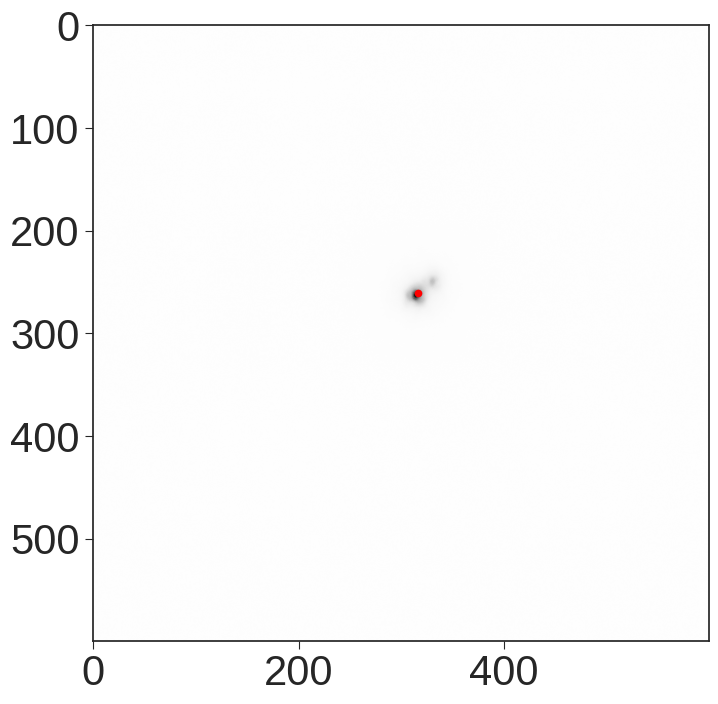

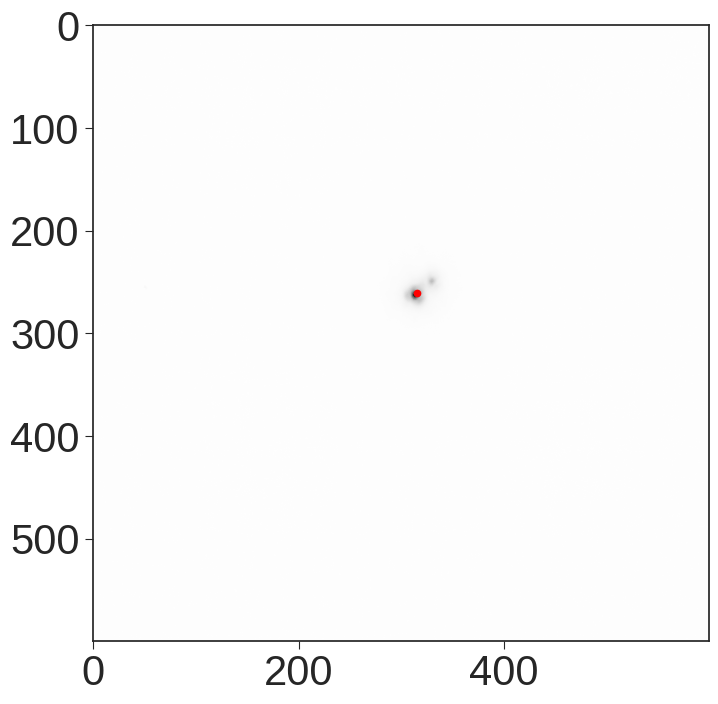

...

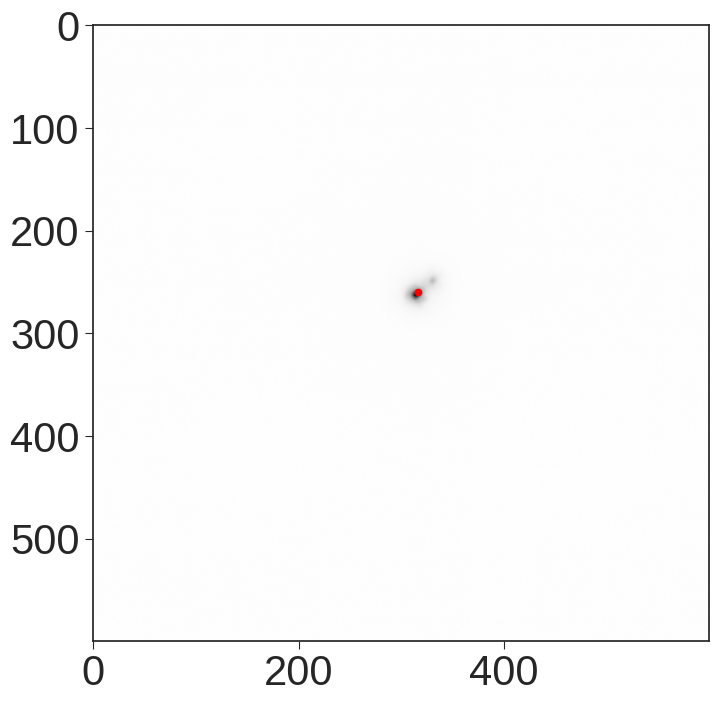

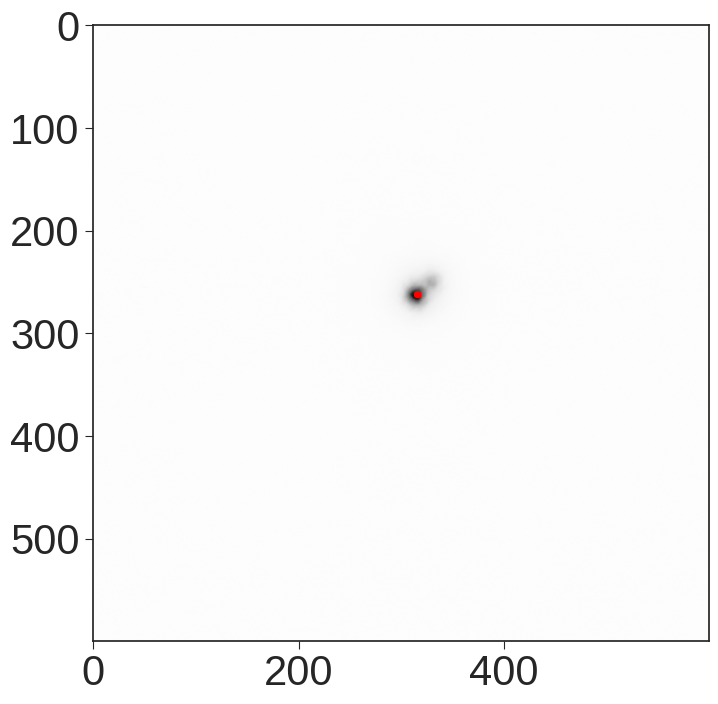

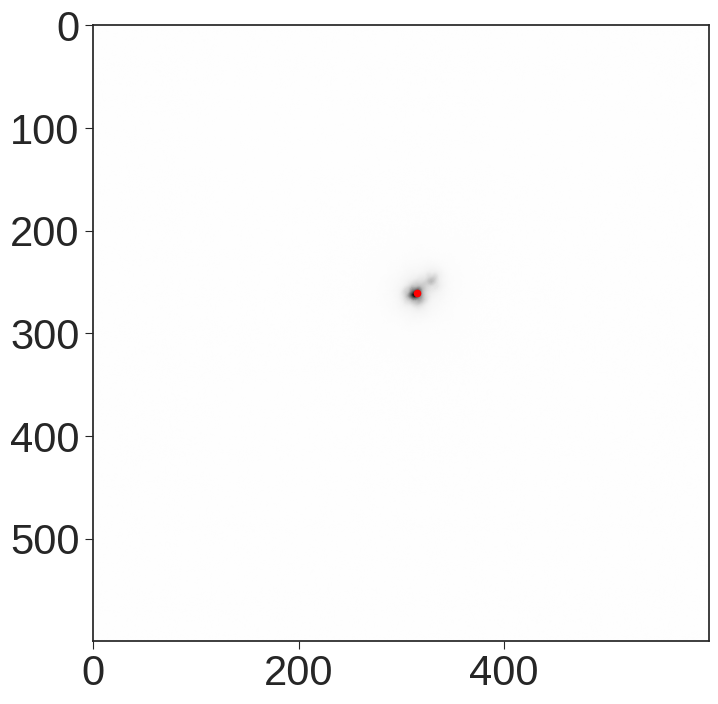

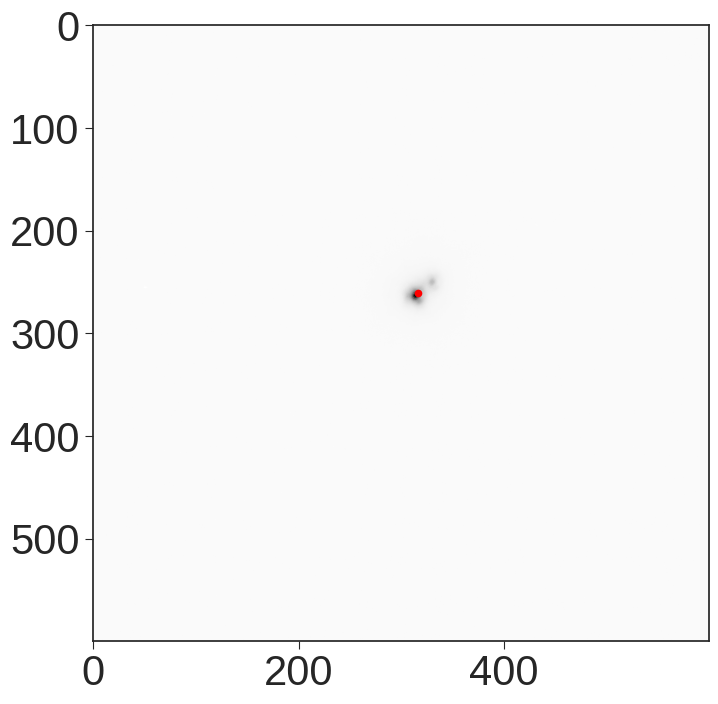

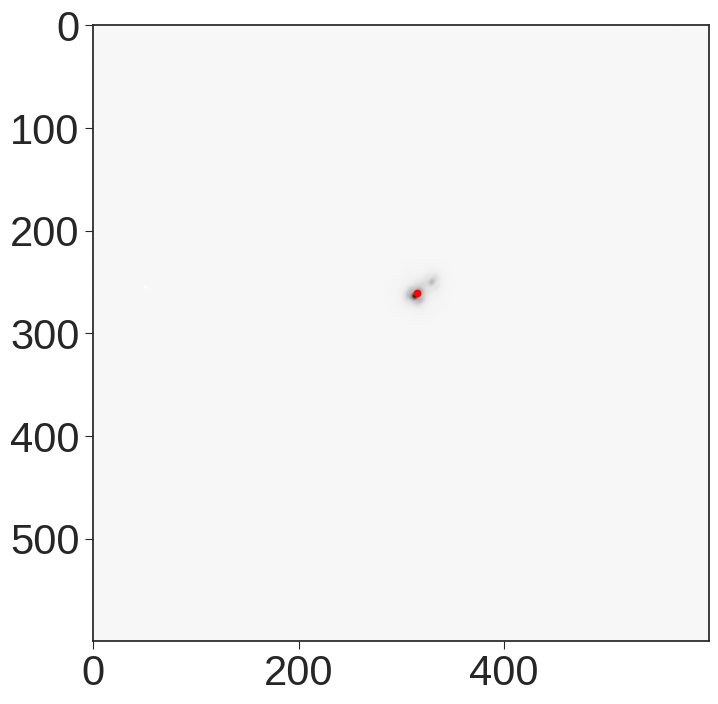

/home/tehan/anaconda3/envs/stenv/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3505: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [10]:
################################
#       Image Shifting         #
################################

final_image = image_shift(object_list, center, sky_flat_darkcor_data_out, datadir)

/tmp/ipykernel_20691/1015570687.py:5: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(np.log10(final_image), origin='lower', cmap='gray')
/tmp/ipykernel_20691/1015570687.py:5: RuntimeWarning: invalid value encountered in log10
  plt.imshow(np.log10(final_image), origin='lower', cmap='gray')


<Figure size 1200x800 with 0 Axes>

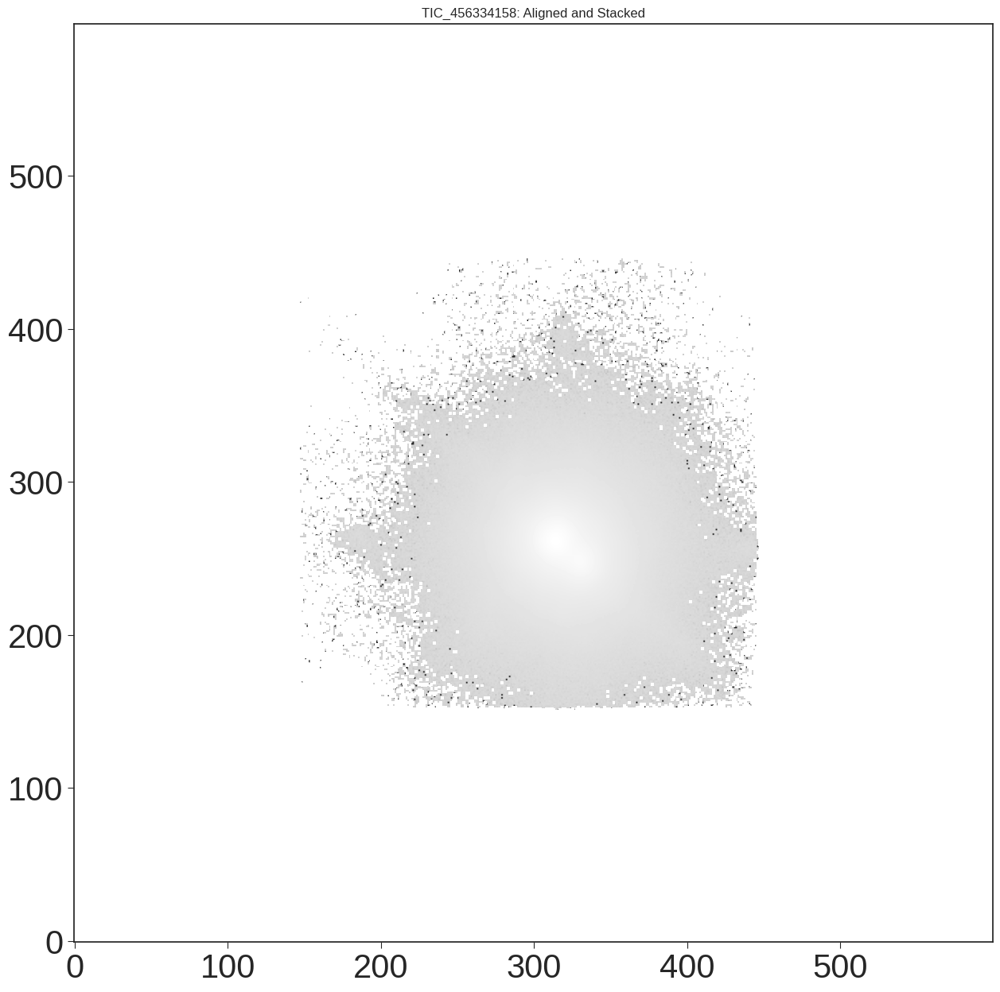

In [11]:
## show the final image array as an image:
plt.figure(1)
plt.figure(figsize=(15, 15));
plt.title(target + ': Aligned and Stacked');
plt.imshow(np.log10(final_image), origin='lower', cmap='gray')
plt.savefig(outdir + target + f'_filter_{object_filter_list2[0]}.png', dpi=300)

<Figure size 1200x800 with 0 Axes>

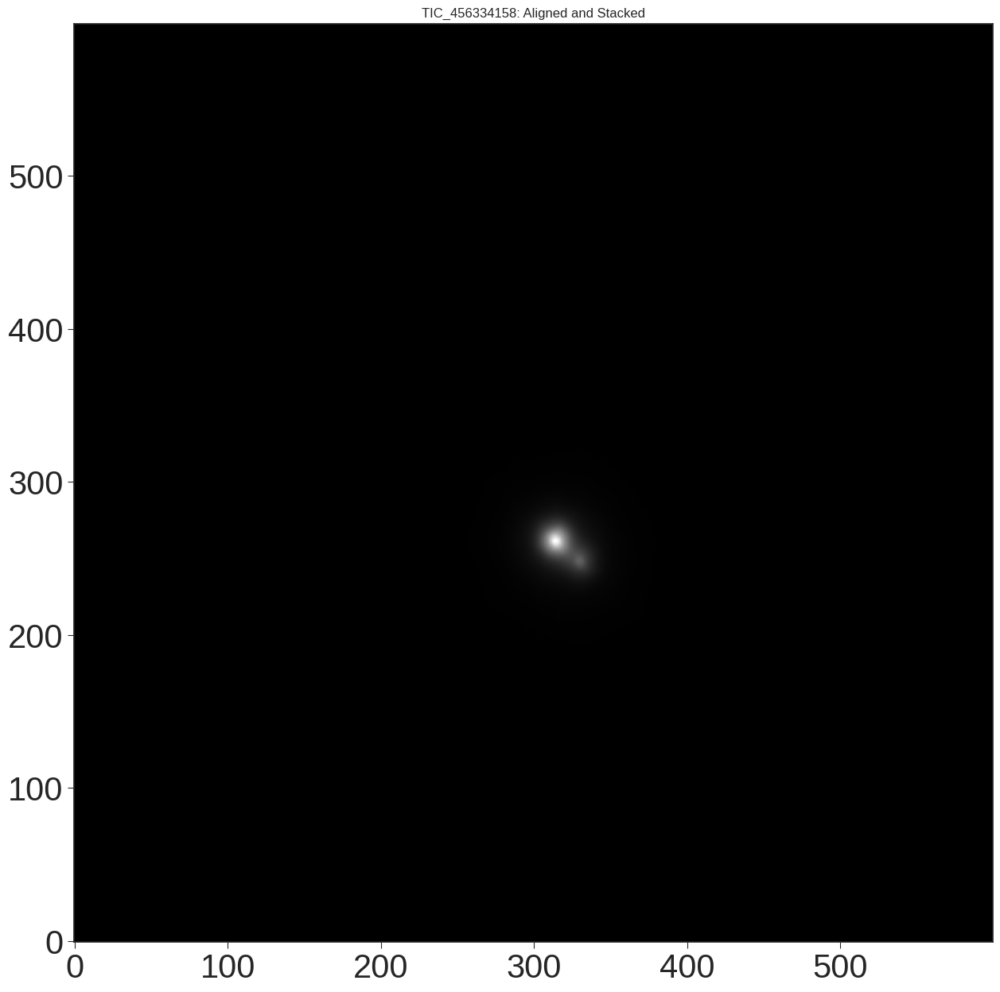

In [12]:
## show the final image array as an image:
plt.figure(1)
plt.figure(figsize=(15, 15));
plt.title(target + ': Aligned and Stacked');
plt.imshow(final_image, origin='lower', cmap='gray')
plt.savefig(outdir + target + f'_filter_{object_filter_list2[0]}_linear.png', dpi=300)

In [13]:
## Clean up and file saving

#del cr_flat_darkcor_data_out

print(len(object_filter_list))
#change the size of the image in the header file


from astropy.nddata import Cutout2D
from astropy.io import fits
from astropy.wcs import WCS

hdul = fits.open(f'{datadir}{object_list[0]}')
original_data = hdul[0].data
original_header = hdul[0].header
for key in ['EQUINOX', 'CRPIX1', 'CRPIX2', 'CRVAL1', 'CRVAL2', 'CD1_1', 'CD1_2', 'CD2_1', 'CD2_2',  'CRDER1', 'CRDER2', 'CSYER1', 'CSYER2', 
            'CRPIX1C', 'CRPIX2C', 'CRVAL1C', 'CRVAL2C', 'CD1_1C', 'CD1_2C', 'CD2_1C', 'CD2_2C', 'CRDER1C', 'CRDER2C', 'CSYER1C', 'CSYER2C']:
    original_header[key] = float(original_header[key])
original_wcs = WCS(original_header)
position = (700, 1350)  # Example position (x, y) in pixels
size = (600, 600)  # Example size (width, height) in pixels
cutout = Cutout2D(original_data, position, size, wcs=original_wcs, mode='strict')
cutout_wcs = cutout.wcs.to_header()
print(original_wcs.pixel_to_world([700], [1350]))
print(cutout.wcs.pixel_to_world([300], [300]))
# cutout_wcs['NAXIS1'] = 600
# cutout_wcs['NAXIS2'] = 600
# cutout_wcs['CRPIX1'] = 300
# cutout_wcs['CRPIX2'] = 350

    
cutout_hdulist = fits.PrimaryHDU(data=cutout.data, header=cutout_wcs)
cutout_wcs
if len(object_filter_list) > 1:
    fits.writeto(outdir + target + '_final' + f'_filter_{object_filter_list2[0]}.fits', final_image, cutout_wcs)
else:
    fits.writeto(outdir + target + '_final.fits', final_image, cutout_wcs)

#del raw_image_data
#del darkcor_data_out


2
<SkyCoord (FK5: equinox=2000.0): (ra, dec) in deg
    [(134.90764081, 53.73508795)]>
<SkyCoord (FK5: equinox=2000.0): (ra, dec) in deg
    [(134.90764081, 53.73508795)]>


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set MJD-BEG to 60338.486590 from DATE-BEG'. [astropy.wcs.wcs]
